# Project 4 - Vehicle Detection and Tracking

## Goal:
* Create a software pipeline that takes a video as an input and identifies vehicle's location.

#### To achieve this goal here are the steps taken:
* Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier Linear SVM classifier.

* Optionally, you can also apply a color transform and append binned color features, as well as histograms of color, to your HOG feature vector.

* Note: for those first two steps don't forget to normalize your features and randomize a selection for training and testing.

* Implement a sliding-window technique and use your trained classifier to search for vehicles in images.

* Run your pipeline on a video stream (start with the test_video.mp4 and later implement on full project_video.mp4) and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.

* Estimate a bounding box for vehicles detected.


#### Histogram of Oriented Gradients (HOG)

##### 1. Explain how (and identify where in your code) you extracted HOG features from the training images.

To extract the features on each training image I've used the function "extract_features" developed during the lectures.

This function calls "get_hog_features" / "bin_spatial" and "color_hist" and these features, after concatenated represent the features considered for the training.

This function/sub-functions were called on a YCrCb color space image, and after trial and error (and also better training accuracy) initially I've increased the HOG orient parameter up to 36, but settle back again in 9, increased the HOG channels to "ALL" and kept the other remaining HOG parameters to "standard values" (i.e. the ones used in the lectures ppcell=8 and cpblock=2).

As stated I've also extracted the color histogram and and spatial binning of each image (although I am not 100% convinced about the additional benefit of the last feature).

Here is an example of the HOG features extracted:


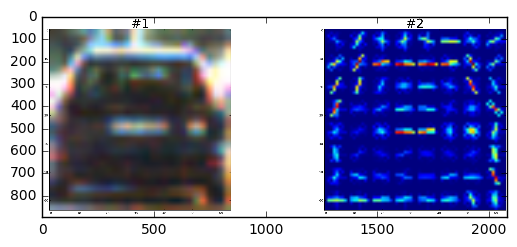

In [5]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img=mpimg.imread('./output_images/0.png')
plt.imshow(img)
plt.show()

##### 2. Explain how you settled on your final choice of HOG parameters.

The choice of HOG parameters was a combination of trial and error and also good results with the SVC training (the highest accuracy was achieved when I've tried YCrCb color space, and therefore it was the color space used).

On other hand I've chosen a higher than "standard" orientations parameters because I believe it gave me a good vehicle detection/false positive ratio later in the predictions stage due to its clear and distinct image features.


##### 3. Describe how (and identify where in your code) you trained a classifier using your selected HOG features (and color features if you used them).

I have chosen a Linear SVC for classification and to train this classifier I have used the GTI Vehicle Image Database, KITTI and Udacity Extras image sets provided.

Prior training all the above mentioned featured were extracted from the images, scaled (using a StandardScaler) and the inputs/labels were split with a 80%/20% ratio (train/test).

I was very pleased with the accuracy of the classifier but a bit concerned regarding the time taken by the training process.

Here is the output of the training:

"Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 21984
1128.12 Seconds to train SVC...
Test Accuracy of SVC =  0.9943"



### Sliding Window Search

#### 1. Describe how (and identify where in your code) you implemented a sliding window search. How did you decide what scales to search and how much to overlap windows?

I've implemented the sliding window search used in the lectures.
This function takes in an image as input and initially extracts the HOG features for each channel of the whole image. Later it performs a 64x64 window search where it just refers to the relative position of the HOG features already extracted. I've done two alterations to the original function: 1st the cells_per_step were reduced to 1 so it covers more area of the image (similar to overlap), the other change performed was that this function, in addition of returning an image with boxes drawn around the the positive matches, also returns a list of lists with the position of the positive predictions (i.e. where the classifier believes there's a car), that will be later used in the heat functions to try to reduce false positives and group boxes belonging to the same car.


In [ ]:
def find_cars(img, ystart, ystop, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins):
    box_list=[]
    draw_img = np.copy(img)
    #img = img.astype(np.float32)/255
    
    if ystop==None:
        ystop=img.shape[1]
    
    img_tosearch = img[ystart:ystop,:,:]
    ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YCrCb')
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
        
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell)-1
    nyblocks = (ch1.shape[0] // pix_per_cell)-1 
    nfeat_per_block = orient*cell_per_block**2
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell)-1 
    cells_per_step = 1  # Instead of overlap, define how many cells to step. Original=2
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))

            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell

            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
          
            # Get color features
            
            spatial_features = bin_spatial(subimg, size=spatial_size)
            
            hist_features = color_hist(subimg, nbins=hist_bins)

            # Scale features and make a prediction
            test_features = X_scaler.transform(np.hstack((spatial_features, hist_features, hog_features)).reshape(1, -1))
            
            test_prediction = svc.predict(test_features)
            
            if test_prediction == 1:
                xbox_left = np.int(xleft*scale)
                ytop_draw = np.int(ytop*scale)
                win_draw = np.int(window*scale)
                rect_coord=((xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart))
                cv2.rectangle(draw_img,rect_coord[0],rect_coord[1],(0,0,255),6) 
                box_list.append(rect_coord)
    return draw_img,box_list


### 2. Show some examples of test images to demonstrate how your pipeline is working. What did you do to optimize the performance of your classifier?

Here is an example of a test image where the cars where identified:


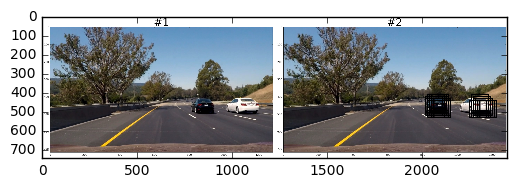

In [2]:
img=mpimg.imread('./output_images/1.png')
plt.imshow(img)
plt.show()

#### Video Implementation

### 1. Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (somewhat wobbly or unstable bounding boxes are ok as long as you are identifying the vehicles most of the time with minimal false positives.)



In [6]:
import io
import base64
from IPython.display import HTML

video = io.open('./output_images/submi.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

#### 2. Describe how (and identify where in your code) you implemented some kind of filter for false positives and some method for combining overlapping bounding boxes.

To reduce the false positives and to combine overlapping boxes I've applied a heat map strategy, where after identifying the car's bounding boxes, these positions where sequencially added to a heat map and then thresholded to identify (or to give more confidence to this identification).
I then used the label function to make the match of each "hot zone"/"box area" with a vehicle. The boxes that you see in the video are drawn to cover these "hot areas".

This heat map was being saved/updated (for each new "heat zone" added the oldest was discarded) and it was carried over along the whole video.

In order to reduce overlapping boxes/and to increase the speed of processing, I opted to discard 15 consecutive frames for every 2 frames processed. I've noticed that I didn't lose much information.

Here is an example of an image and its corresponding heat map.


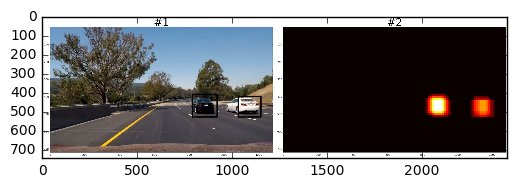

In [3]:
img=mpimg.imread('./output_images/2.png')
plt.imshow(img)
plt.show()

#### 1. Briefly discuss any problems / issues you faced in your implementation of this project. Where will your pipeline likely fail? What could you do to make it more robust?

First, this project took me roughly 17 hours (and counting) to complete <- major frustration.
Besides that, I am again very pleased with the result and with what I've learned.

Issues I've faced:
-didn't know that a HOG orientation parameter higher than let's say 15, didn't give me a better performance and it was only wasting time during the classifier training. The same with processing every frame, it only wasted time compared with the information gain.

To make the pipeline more robust, I believe that it should be able to detect the cars on the other lane. Even though I know that the training data had the rear view of the cars, I was expecting that at least some of the features were similar to the classfier, resulting in more vehicles detected.

I am also worried about the speed of my pipeline. I takes long time to process the video. As future work I could be looking into improvements around performance

Finally, and it's common to the previous projects, would be interesting to see how the pipeline works during the night, reduced light, reduced visibility, fog

